# Reef Check 

[Reef Check](https://www.reefcheck.org/) is a nonprofit organization dedicated to saving our reefs and oceans. They have collected ocean temperature data at a number of sites along the West coast of USA. 

This is an initial exploration of that data. I will expand this notebook as I go.

In [1]:
import glob
import os
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import tabulate

import reef_check as reef_check
import graphs as graphs

import plotly.io as pio
from plotly.offline import init_notebook_mode

pio.renderers.default = "notebook_connected"
init_notebook_mode(connected=True)

Pick a location that has data from several years and read the csv files in that directory

In [2]:
data_dir = '/Users/jenny.folkesson/Data/reef_check/'

There can be data fluctuations at the beginning and end of the time series, perhaps due to the device being activated before being placed in the water, and/or taken out of the water before being deactivated. 
In case there's no knowledge of when the device was deployed and retrieved, change point detection can be performed for the first and last 14 days of data in each time series and if change points are detected, the time series is cropped to remove dubious data. Below is an example of change point detection.

For most of the data, this is not necessary because there is a file named 'HOBO_deployment_metadata.csv' which lists all times of deployment and retreival of devices for each site. 

In [3]:
# Pick 'Little Corona'
site_name = 'Little Corona'
site_dir = os.path.join(data_dir, 'Southern California/Little Corona/')
file_paths = glob.glob(os.path.join(site_dir, '*.csv'))
file_paths.sort()
temp_data = pd.read_csv(file_paths[1], skiprows=1)
temp_data = reef_check.format_data(temp_data)
temp_data = reef_check.change_point_detection(temp_data, debug=True)

Now read all the time series in the directory.

In [4]:
temperature_data, reef_meta = reef_check.read_data_and_coords(data_dir)
reef_meta

,Site,Code,Region,Lat,Lon,depth (ft),sst_lat,sst_lon,idx_lat,idx_lon
0,Big Rock,BGR,Southern California,34.035132,-118.608050,20.433333,33.875,-118.625,495,965
1,Bird Rock,BRK,Southern California,33.462763,-118.489879,35.000000,33.375,-118.375,493,966
2,Blue Cavern,BCN,Southern California,33.441170,-118.465350,14.850000,33.375,-118.375,493,966
3,Blue Cavern II,BCN2,Southern California,33.443433,-118.473883,28.500000,33.375,-118.375,493,966
4,Broomtail Reef,BRF,Southern California,32.694319,-117.267903,35.800000,32.625,-117.375,490,970
...,...,...,...,...,...,...,...,...,...,...
72,Point Arena Reference,PAR,Northern California,38.910282,-123.715926,37.400000,38.875,-123.625,515,945
73,Portuguese Beach,PRB,Northern California,39.302010,-123.803727,15.400000,39.375,-123.875,517,944
74,Stillwater Sonoma,SWS,Northern California,38.546010,-123.299820,22.875000,38.625,-123.375,514,946
75,Trinidad,TRI,Northern California,41.054240,-124.144680,15.000000,41.125,-124.125,524,943


Plot montly temperatures across each year in the data set.

In [5]:
temp_data = temperature_data[temperature_data['Site'] == site_name]
fig = graphs.line_overlaid_years(temp_data, site_name)
fig.show()

## OISST Data

NOAA provides a long term climate record called [OISST](https://www.ncei.noaa.gov/products/optimum-interpolation-sst) which stands for Optimum Interpolation Sea Surface Temperature. It incorporates observations from different platforms (satellites, ships, buoys and Argo floats) into a regular global grid, it's publicly available for download in netCDF4 file format. The spatial resolution of the grid is 0.25 degrees.
I've downloaded data from years 2017-2023 which are the range of years Reef Check currently has ocean temperature data from.

Below is a sea surface temperature map from December 31, 2023, for reference. Land masses are masked out.

In [6]:
sst_dir = reef_check.get_sst_path(data_dir)
sst_path = os.path.join(sst_dir, '202312/oisst-avhrr-v02r01.20231231.nc')
sst, (sst_lat, sst_lon) = reef_check.read_oisst_file(sst_path, mask_out=True)
fig = graphs.oisst_map(sst, sst_lat, sst_lon)
fig.show()

For each date in the Reef Check dataset, we can find the closest matching geographic coordinates in the OISST dataset and compare Reef Check temperatures (which are usually at a depth of 12.5 meters below sea level) and the OISST sea surface temperatures.

In [7]:
fig = graphs.line_consecutive_years(temp_data, site_name)
fig.show()

Temperatures are fairly well correlated with the Reef Check data showing somewhat larger variations. However the sea surface temperature does seem to be quite a bit lower than Reef Check data starting at the last half of 2020 for some reason.

## Reef Check Coordinates and Nearest OISST Coordinates

Below is a map with Reef Check coordinates in blue and the closest OISST coordinates in green. The OISST coordinates have a spatial resolution of 0.25 degrees, which results in that several Reef Check sites are mapped to the same OISST latitude and longitude. 
Future work includes upsampling and interpolating the OISST dataset for more local estimates.

In [8]:
fig = graphs.coordinate_map(reef_meta)
fig.show()

Reef Check coordinates are in blue and OISST coordinates are in green. You can hover over the coordinates to see the site name they correspond to. Several Reef Check sites are assigned to the same OISST coordinates because the spatial resolution of the OISST coordinates is 0.25 degrees.

## Average Temperatures Over Time

Below is a graph of the average Reef Check and OISST sea surface temperatures over time for all sites.

In [9]:
fig = graphs.mean_temperature_lines(temperature_data, title_txt='Mean Temperatures, All Data')
fig.show()

Solid lines are the mean temperatures, and opaque surfaces underneath span plus/minus one standard deviation from the mean. 
It looks like the biggest temperature differences between sea surface temperatures and Reef Check temperatures occur during the warmer summer months. Below are the same graphs but separated by Southern, Central, and Northern California, and using a weekly rather than daily average.

In [10]:
# Join tables to select for region
merged_data = temperature_data.merge(reef_meta, on='Site', how='left')
temp_data = merged_data[merged_data['Region'] == 'Northern California']
fig = graphs.mean_temperature_lines(temp_data, freq='W', title_txt='Mean Temperatures, Northern CA')
fig.show()

In [11]:
# Central CA
temp_data = merged_data[merged_data['Region'] == 'Central California']
fig = graphs.mean_temperature_lines(temp_data, freq='W', title_txt='Mean Temperatures, Central CA')
fig.show()

In [12]:
# Southern CA
temp_data = merged_data[merged_data['Region'] == 'Southern California']
fig = graphs.mean_temperature_lines(temp_data, freq='W', title_txt='Mean Temperatures, Southern CA')
fig.show()

In [13]:
fig = graphs.temperature_diff_graph(temperature_data, freq='W', title_txt='Weekly Mean Temperature Difference, All Data')
fig.show()

In [14]:
temp_data = merged_data[merged_data['Region'] == 'Northern California']
fig = graphs.temperature_diff_graph(temp_data, freq='W', title_txt='Weekly Mean Seasonal Temperature Difference, Northern CA')
fig.show()

In [15]:
temp_data = merged_data[merged_data['Region'] == 'Central California']
fig = graphs.temperature_diff_graph(temp_data, freq='W', title_txt='Weekly Mean Seasonal Temperature Difference, Central CA')
fig.show()

In [16]:
temp_data = merged_data[merged_data['Region'] == 'Southern California']
fig = graphs.temperature_diff_graph(temp_data, freq='W', title_txt='Weekly Mean Seasonal Temperature Difference, Southern CA')
fig.show()

The sea surface is warmer during the months June - September compared to the temperatures measured by Reef Check at a depth of 4-18 meters. During the winter months of December - January there is almost no difference in temperature. The largest temperature difference between surface and at the Reef Check sites are in Central California, where the difference can be over 2 degrees Celcius for much of the summer.
We need to analyze how differences in depth of Reef Check's temperature sensors affect the measured temperatures.

## Depth of Sensors

The Reef Check sensors are placed at varying depths. We'll plot the depths to check if depths are random throughout the dataset, or if variations in temperature can be attributed to depth variations. 

In [17]:
fig = graphs.temperature_depth_graph(temperature_data, reef_meta)
fig.show()

The size of the circles signify sensor depth, and the circle colors are related to the mean temperature in August as given by the colorbar to the right of the map. The month of August was chosen since it seems to express the largest temperature difference from the surface during the course of a year. You can also hover over any circle to see the specifics for that site.
It looks like Central California has temperature sensors that are on average placed deeper than Southern and Northern California, which could explain the fairly large temperature differences between summer and winter that we see there. 

The table below shows that temperatures in Central California are indeed measured deeper below the surface on average than the other regions.

In [18]:
depths = reef_meta[['Region', 'depth (ft)']]
mean_depth = depths.groupby(['Region']).mean()
mean_std = depths.groupby(['Region']).std()
mean_depth['std'] = mean_std['depth (ft)']
mean_depth

,depth (ft),std
Region,,
Central California,39.795008,8.784835
Northern California,21.554841,8.061942
Southern California,28.066437,8.398627


From the map above, it looks like the region of Souther California has the largest variability in temperatures. It would be helpful to visualize the temperatures as a function of depth in a scatterplot, which we'll do below.

In [19]:
import importlib
importlib.reload(graphs)
fig = graphs.temp_depth_scatter(temperature_data, reef_meta, month=8)
fig.show()

The scatterplot above seems to indicate a negative correlation between temperature and depth in Southern California in August. Similar trends are not as noticeable for the other regions; both Nothern and Central California has a much smaller temperature range.
Below you can see that all regions have a p-value less than 0.05 for their ordinary least square regression trendlines, with Southern California having the lowest p-value.

In [20]:
stats = [["Region", "Northern", "Central", "Southern"],
         ["R Squared", "", "", ""],
         ["p-value", "", "", ""],
         ["f(x)", "", "", ""]]

results = px.get_trendline_results(fig)
for idx in range(3):
    stats[1][idx + 1] = "{:.5f}".format(results.px_fit_results[idx].rsquared)
    stats[2][idx + 1] = "{:.6f}".format(results.px_fit_results[idx].pvalues[1])
    params = results.px_fit_results[idx].params
    stats[3][idx + 1] = "{:.1f}x + {:.1f}".format(params[1], params[0])

table = tabulate.tabulate(stats, tablefmt='html')
table

Region,Northern,Central,Southern
R Squared,0.32546,0.17989,0.61102
p-value,0.033139,0.019500,0.000001
f(x),-0.0x + 12.6,-0.0x + 14.0,-0.2x + 24.9


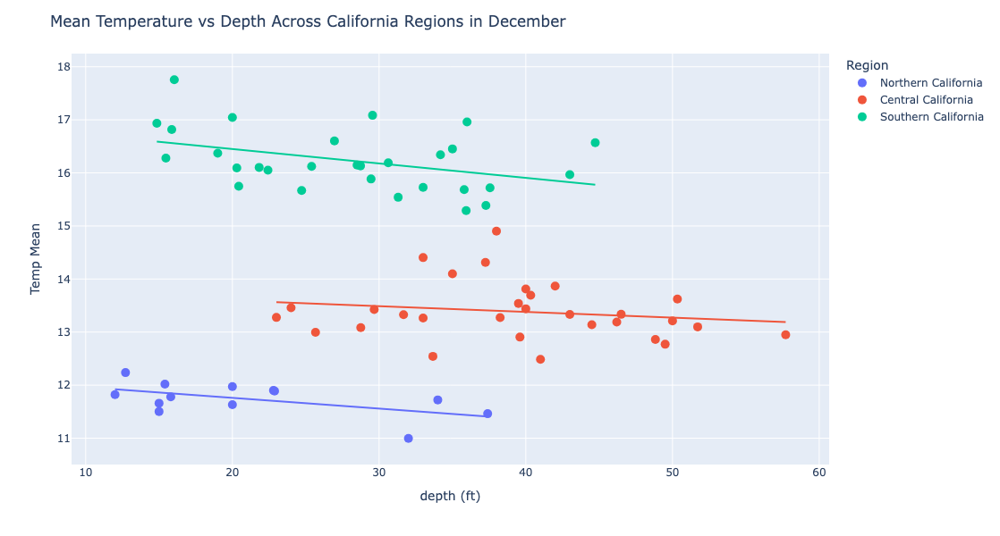

In [21]:
# Same graph with December data
fig = graphs.temp_depth_scatter(temperature_data, reef_meta, month=12)
fig.show()

In [22]:
results = px.get_trendline_results(fig)
for idx in range(3):
    stats[1][idx + 1] = "{:.5f}".format(results.px_fit_results[idx].rsquared)
    stats[2][idx + 1] = "{:.6f}".format(results.px_fit_results[idx].pvalues[1])
    params = results.px_fit_results[idx].params
    stats[3][idx + 1] = "{:.1f}x + {:.1f}".format(params[1], params[0])

table = tabulate.tabulate(stats, tablefmt='html')
table

Region,Northern,Central,Southern
R Squared,0.30670,0.03049,0.15910
p-value,0.049568,0.356081,0.032081
f(x),-0.0x + 12.2,-0.0x + 13.8,-0.0x + 17.0


# Ecosystem Data

Reef Check has collected ecosystem data in California since 2006, by having scuba divers have visiting certain sites and count the density of invertebrates, fish and algae. 
We will start by looking at the distribution of purple urchins.

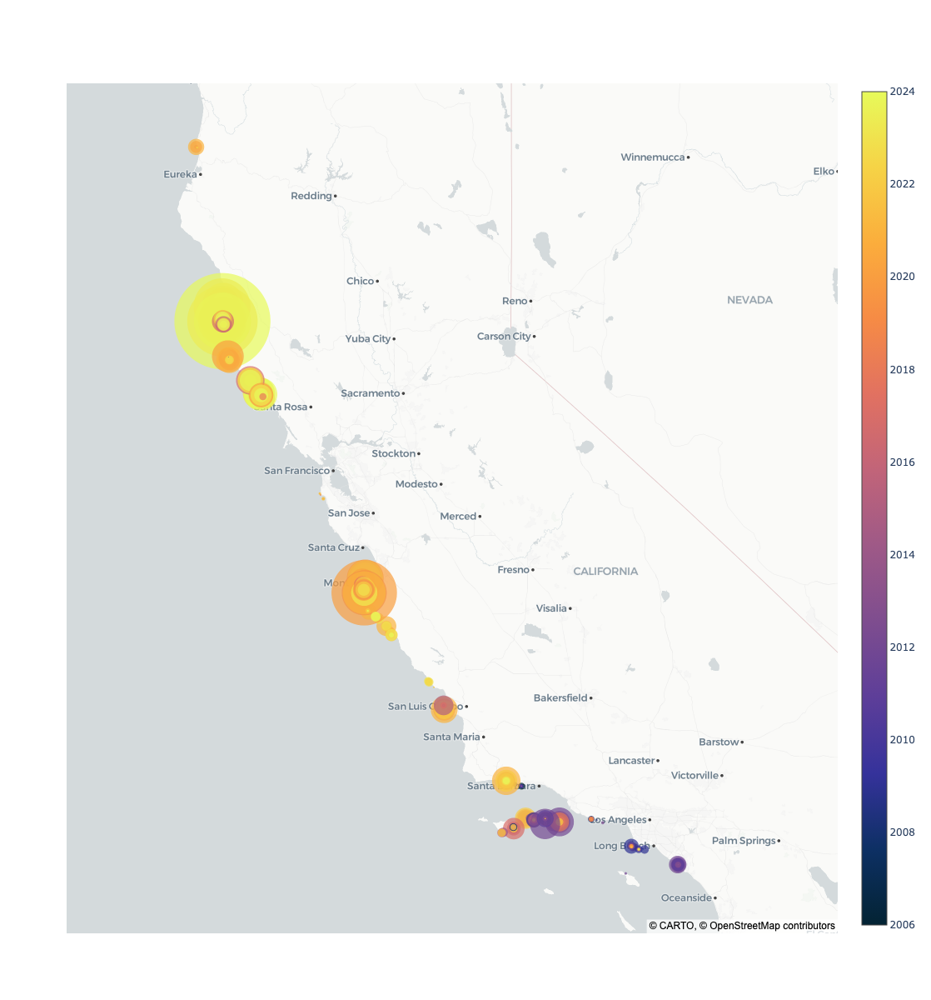

In [23]:
file_name = 'Invert_California_Survey_means_2024.csv'
fig = graphs.ecosystem_data_map(data_dir, file_name)
fig.show()

In the above map, the locations of the circles represent Reef Check sites, the size of the circles represent the density of purple urchins, and the color shows the year the data was collected. The circle colors are half-transparent so that you can see the earlier years (purple) through the more recent years (yellow).

Another way to to look at the data is to show a series of maps, each representing a certain year, see below.

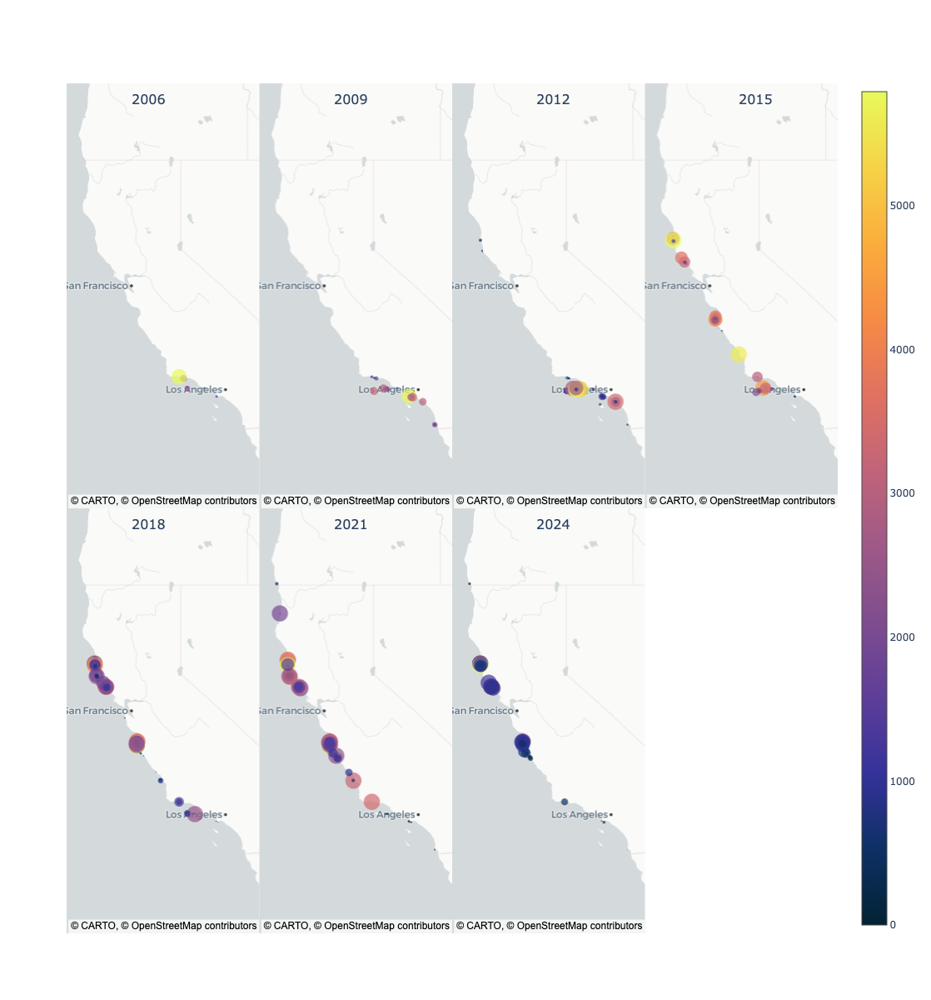

In [49]:
import importlib
importlib.reload(graphs)
fig = graphs.ecosystem_subplots(data_dir, file_name, 'Purple Urchin')
fig.show()

The maps are three years apart to fit the range 2006-2024. In the series of maps above it appears that the purple urchin density has increased and has migrated North.

Below, let's look at the same data in a third way: as an animation over time.

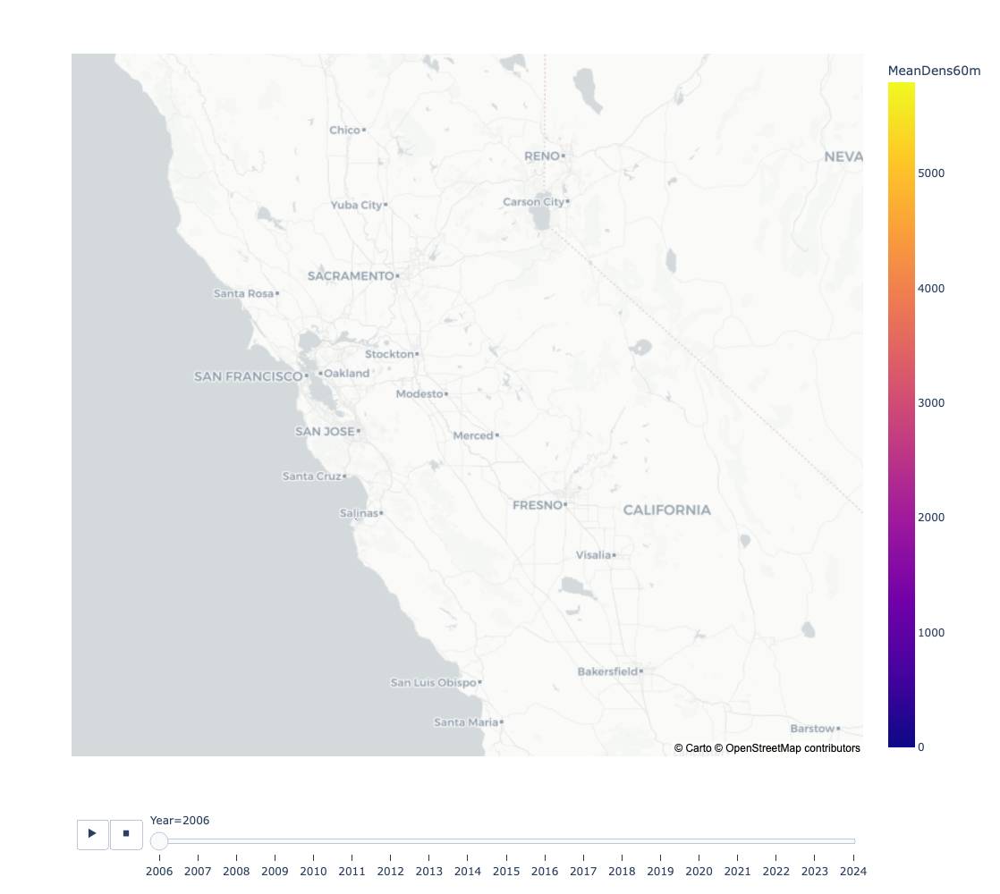

In [52]:
fig = graphs.ecosystem_animation(data_dir, file_name, 'Purple Urchin')
fig.show()

## Crowned Urchins

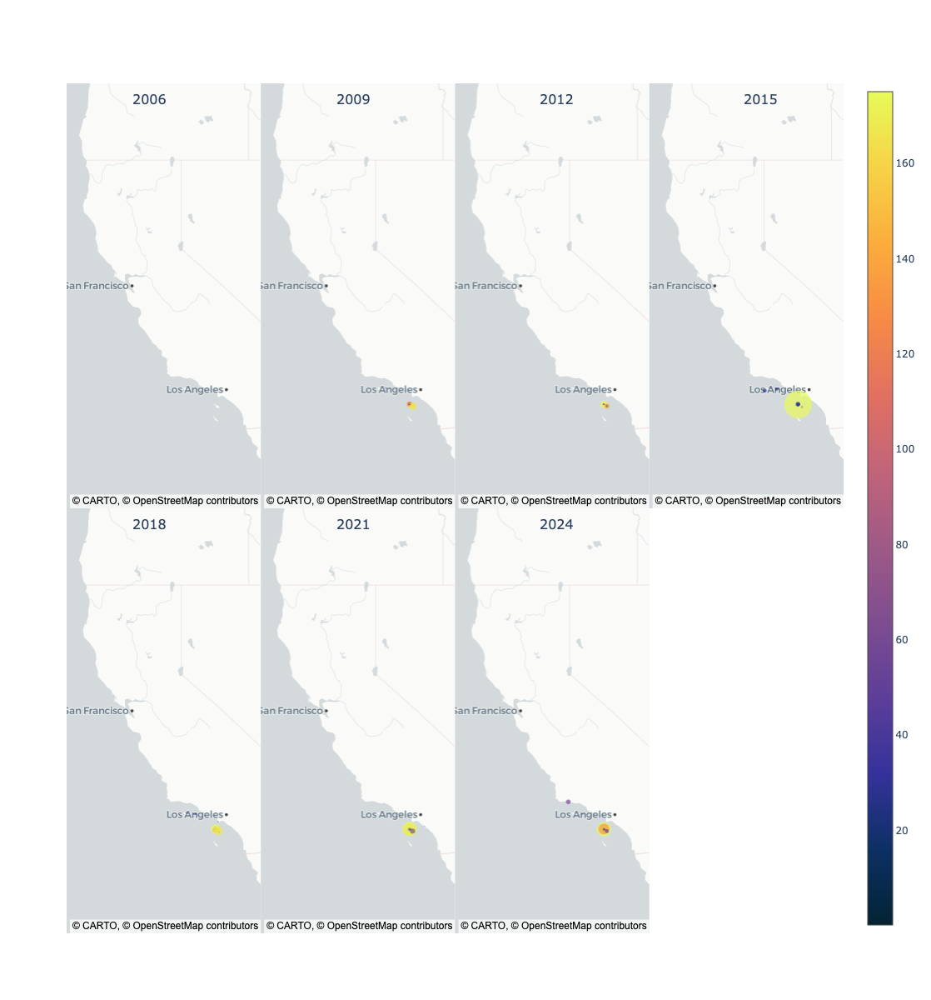

In [51]:
importlib.reload(graphs)
fig = graphs.ecosystem_subplots(data_dir, file_name, 'Crowned Urchin', scale_down=10)
fig.show()